# Vahadane Demo

In [67]:
import numpy as np
import matplotlib.pyplot as plt
import spams
import cv2
import utils
from vahadane import vahadane
from sklearn.manifold import TSNE
import os
%load_ext autoreload
%autoreload 2
%matplotlib inline

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [195]:
directory   = '/home/mathiane/ImgProcessing/Data/'
SOURCE_PATH = directory + 'TNE0878_12237_43701 (copy).jpg'
TARGET_PATH = directory + 'TNE0966_8741_34087.jpg'

# TARGET_PATH = directory +  'TNE0966_8741_34087.jpg'
# SOURCE_PATH = directory + 'TNE0988_37583_875.jpg'
# RESULT_PATH = directory + 'TNE0988_37583_875_to_i1.png'

## Load source and target images

source image size:  (512, 512, 3)
target image size:  (512, 512, 3)


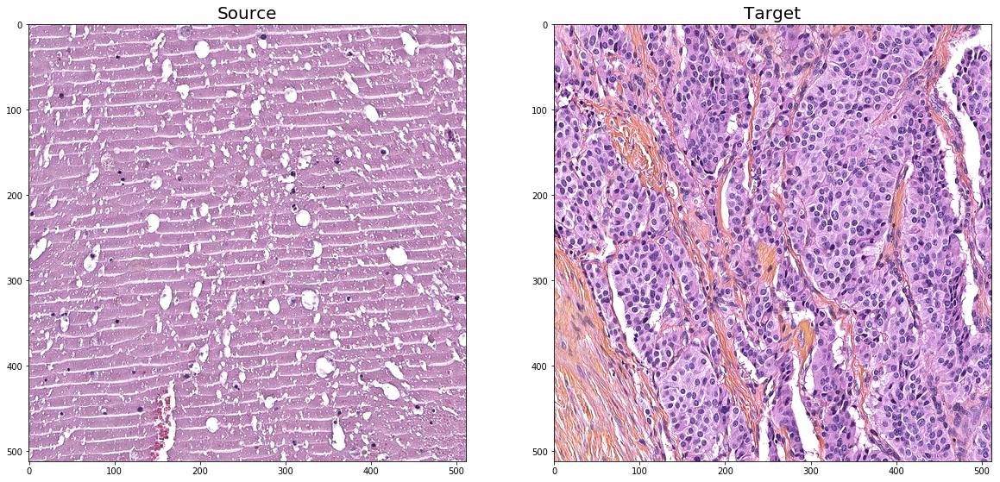

In [196]:
source_image = utils.read_image(SOURCE_PATH)
target_image = utils.read_image(TARGET_PATH)
print('source image size: ', source_image.shape)
print('target image size: ', target_image.shape)
plt.figure(figsize=(20.0, 20.0))
plt.subplot(1, 2, 1)
plt.title('Source', fontsize=20)
plt.imshow(source_image)
plt.subplot(1, 2, 2)
plt.title('Target', fontsize=20)
plt.imshow(target_image)
plt.show()

## Configuration

In [197]:
vhd = vahadane(STAIN_NUM=3, LAMBDA1=0.01, LAMBDA2=0.01, fast_mode=0, getH_mode=0, ITER=50)
vhd.show_config()

STAIN_NUM = 3
THRESH = 0.9
LAMBDA1 = 0.01
LAMBDA2 = 0.01
ITER = 50
fast_mode = 0
getH_mode = 0


## Stain Separation and Color Normalization

In [198]:
Ws, Hs = vhd.stain_separate(source_image)
vhd.fast_mode=0;vhd.getH_mode=0;
Wt, Ht = vhd.stain_separate(target_image)

C Value 1
W 
 [[0.5173632  0.25921837 0.36559526]
 [0.71363202 0.94335088 0.79778041]
 [0.47229721 0.20711097 0.47946482]]
W Shuffle 
 [[0.36559526 0.25921837 0.5173632 ]
 [0.79778041 0.94335088 0.71363202]
 [0.47946482 0.20711097 0.47229721]]
stain separation time: 0.28451991081237793 s
C Value 1
W 
 [[0.56261116 0.24154499 0.17777854]
 [0.74603784 0.95352883 0.64395974]
 [0.35622497 0.18010768 0.74411736]]
W Shuffle 
 [[0.17777854 0.24154499 0.56261116]
 [0.64395974 0.95352883 0.74603784]
 [0.74411736 0.18010768 0.35622497]]
stain separation time: 0.2757852077484131 s


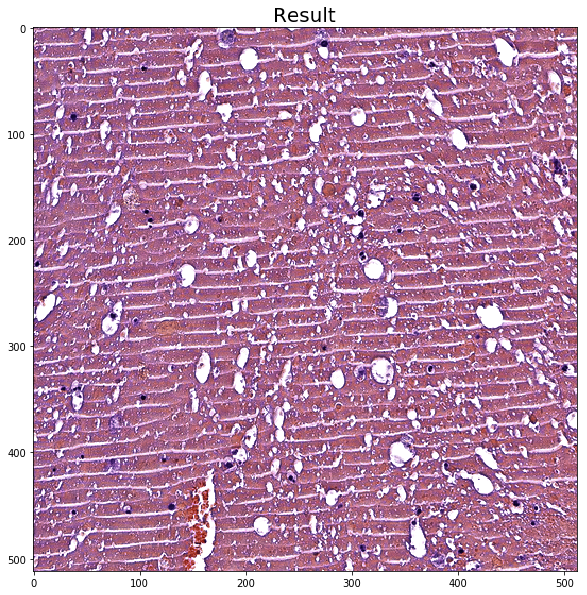

True

In [199]:
img = vhd.SPCN(source_image, Ws, Hs, Wt, Ht)
plt.figure(figsize=(20.0, 10.0))
plt.title('Result', fontsize=20)
plt.imshow(img)
plt.show()
cv2.imwrite(RESULT_PATH, cv2.cvtColor(img, cv2.COLOR_RGB2BGR))

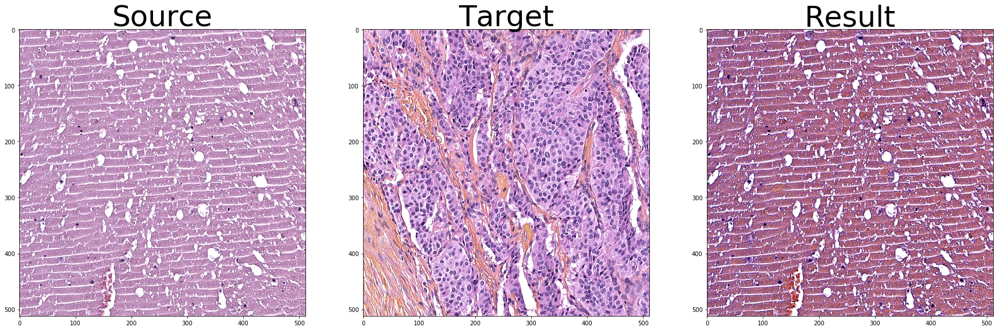

In [200]:
plt.figure(figsize=(30, 10))
plt.subplot(1,3,1)
plt.title('Source', fontsize=50)
plt.imshow(source_image)
plt.subplot(1,3,2)
plt.title('Target', fontsize=50)
plt.imshow(target_image)
plt.subplot(1,3,3)
plt.title('Result', fontsize=50)
plt.imshow(img)
plt.savefig(RESULT_PATH)
plt.show()

## One target for different sources

In [103]:
import spams
import numpy as np
import cv2
import time


class vahadane(object):
    
    def __init__(self, STAIN_NUM=2, THRESH=0.9, LAMBDA1=0.01, LAMBDA2=0.01, ITER=100, fast_mode=0, getH_mode=0):
        self.STAIN_NUM = STAIN_NUM
        self.THRESH = THRESH
        self.LAMBDA1 = LAMBDA1
        self.LAMBDA2 = LAMBDA2
        self.ITER = ITER
        self.fast_mode = fast_mode # 0: normal; 1: fast
        self.getH_mode = getH_mode # 0: spams.lasso; 1: pinv;
        self.Wt = np.array(())
        self.WtSortIndex = np.array(())

    def show_config(self):
        print('STAIN_NUM =', self.STAIN_NUM)
        print('THRESH =', self.THRESH)
        print('LAMBDA1 =', self.LAMBDA1)
        print('LAMBDA2 =', self.LAMBDA2)
        print('ITER =', self.ITER)
        print('fast_mode =', self.fast_mode)
        print('getH_mode =', self.getH_mode)


    def getV(self, img):
        
        I0 = img.reshape((-1,3)).T
        I0[I0==0] = 1
        V0 = np.log(255 / I0)

        img_LAB = cv2.cvtColor(img, cv2.COLOR_RGB2LAB)
        mask = img_LAB[:, :, 0] / 255 < self.THRESH
        I = img[mask].reshape((-1, 3)).T
        I[I == 0] = 1
        V = np.log(255 / I)
        #rint('V0 shape ', V0.shape)
        #print('V shape ', V.shape)
        return V0, V
    
    def setWt(self, Wt):
        self.Wt = Wt
        self.WtSortIndex = np.argsort(Wt, axis=1)
        
    def setHt(self, Ht):
        self.Ht = Ht

    def getW(self, V):
        print('HELLO2')
        W = spams.trainDL(np.asfortranarray(V), K=self.STAIN_NUM, lambda1=self.LAMBDA1, iter=self.ITER, mode=2, modeD=0, posAlpha=True, posD=True, verbose=False)
        W = W / np.linalg.norm(W, axis=0)[None, :]
        print('self.WtSortIndex ',self.WtSortIndex)
        
        if self.Wt.size == 0:
            return W
        else:
            dist_ind = []
            pos = [[0,1,2], [0,2,1],
                  [1,0,2], [1,2,0],
                  [2,1,0], [2,0,1]]
            print('Before order W ', W)
            for ele in pos:
                print(ele)
                
                #print('Before W index sort ' , np.argsort(W, axis=1))
                IndexIndexWtSorted = {list(self.WtSortIndex[0,:])[i]:i for i in range(len(list(self.WtSortIndex[0,:])))}
                IndMin = np.argmin(W[0,:])
                IndMax = np.argmax(W[0,:])
                IndMid = list(set([0,1,2]) - set([IndMin, IndMax]))[0]
                #print('IndMin', IndMin, 'IndMid', IndMid, 'IndMax', IndMax)
                posExpMax = IndexIndexWtSorted[2]
                posExpMin = IndexIndexWtSorted[0]
                posExpMid = IndexIndexWtSorted[1]
                #print('posExpMin', posExpMin,  'posExpMid', posExpMid, 'posExpMax', posExpMax)
                order = [-1,-1,-1]
                order[posExpMax] = IndMax
                order[posExpMin] = IndMin
                order[posExpMid] = IndMid
                #print('order' , order)
                W = W[:, ele]
                print('W ', W)
                #print('W index sort ' , np.argsort(W, axis=1))
                dist_ind.append( (self.Wt - W[:, ele])**2.sum())
            index_min_order = dist_ind.index(min(dist_ind))
            print('dist_ind ',dist_ind, ' pos[index_min_order] ',  pos[index_min_order])
            W = W[:, pos[index_min_order]]   
            print('W ', W)                                                         
            return W

    def getH(self, V, W):
        if (self.getH_mode == 0):
            H = spams.lasso(np.asfortranarray(V), np.asfortranarray(W), mode=2, lambda1=self.LAMBDA2, pos=True, verbose=False).toarray()
        elif (self.getH_mode == 1):
            H = np.linalg.pinv(W).dot(V);
            H[H<0] = 0
        else:
            H = 0
        return H


    def stain_separate(self, img):
        start = time.time()
        if (self.fast_mode == 0):
            V0, V = self.getV(img)
            W = self.getW(V)
            H = self.getH(V0, W)
        elif (self.fast_mode == 1):
            m = img.shape[0]
            n = img.shape[1]
            grid_size_m = int(m / 5)
            lenm = int(m / 20)
            grid_size_n = int(n / 5)
            lenn = int(n / 20)
            W = np.zeros((81, 3, self.STAIN_NUM)).astype(np.float64)
            for i in range(0, 4):
                for j in range(0, 4):
                    px = (i + 1) * grid_size_m
                    py = (j + 1) * grid_size_n
                    patch = img[px - lenm : px + lenm, py - lenn: py + lenn, :]
                    V0, V = self.getV(patch)
                    W[i*9+j] = self.getW(V)
            W = np.mean(W, axis=0)
            V0, V = self.getV(img)
            H = self.getH(V0, W)
        print('stain separation time:', time.time()-start, 's')
        return W, H


    def SPCN(self, img, Ws, Hs):
        Hs_RM = np.percentile(Hs, 99)
        Ht_RM = np.percentile(self.Ht, 99)
        Hs_norm = Hs * Ht_RM / Hs_RM
        Vs_norm = np.dot(self.Wt, Hs_norm)
        Is_norm = 255 * np.exp(-1 * Vs_norm)
        I = Is_norm.T.reshape(img.shape).astype(np.uint8)
        return I


SyntaxError: invalid syntax (<ipython-input-103-0bfb4dacb253>, line 87)

HELLO2
self.WtSortIndex  []
stain separation time: 0.2317042350769043 s
HELLO2
self.WtSortIndex  []
stain separation time: 0.17249321937561035 s

 Sources 
 ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
TNE0952
TNE0966
TNE0988
TNE0882
TNE0882
TNE0878
TNE0878
TNE0277
TNE0289
HELLO2
self.WtSortIndex  [[2 1 0]
 [0 2 1]
 [1 0 2]]
stain separation time: 0.2293257713317871 s
1 



HELLO2
self.WtSortIndex  [[2 1 0]
 [0 2 1]
 [1 0 2]]
stain separation time: 0.22354388236999512 s
2 



HELLO2
self.WtSortIndex  [[2 1 0]
 [0 2 1]
 [1 0 2]]
stain separation time: 0.21024274826049805 s
3 



HELLO2
self.WtSortIndex  [[2 1 0]
 [0 2 1]
 [1 0 2]]
stain separation time: 0.2148604393005371 s
4 



HELLO2
self.WtSortIndex  [[2 1 0]
 [0 2 1]
 [1 0 2]]
stain separation time: 0.21586346626281738 s
5 



HELLO2
self.WtSortIndex  [[2 1 0]
 [0 2 1]
 [1 0 2]]
stain separation time: 0.2350161075592041 s
6 



HELLO2
self.WtSortIndex  [[2 1 0]
 [0 2 1]
 [1 0 2]]
stain separation time: 0.23200654983520508 s
7 



HE

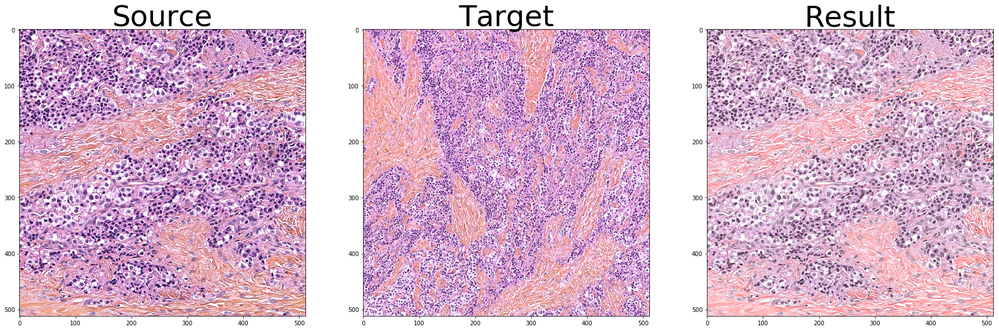

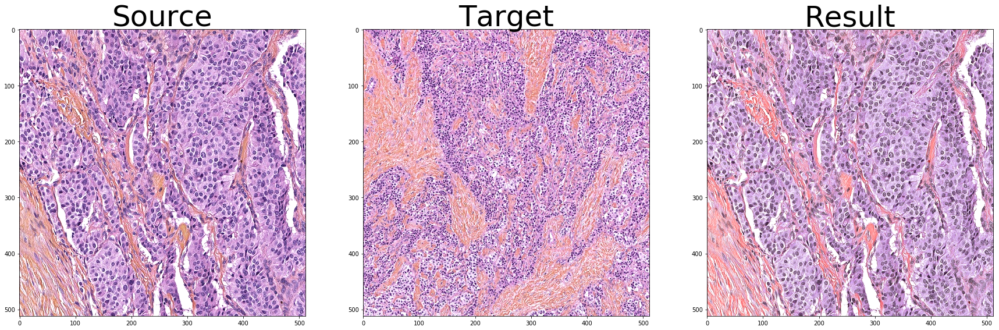

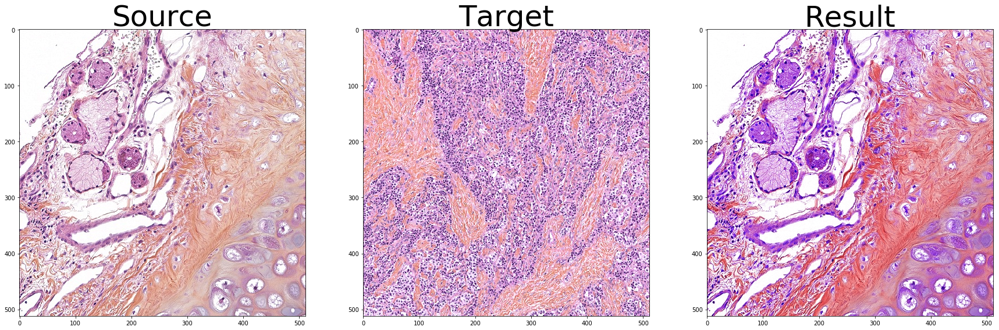

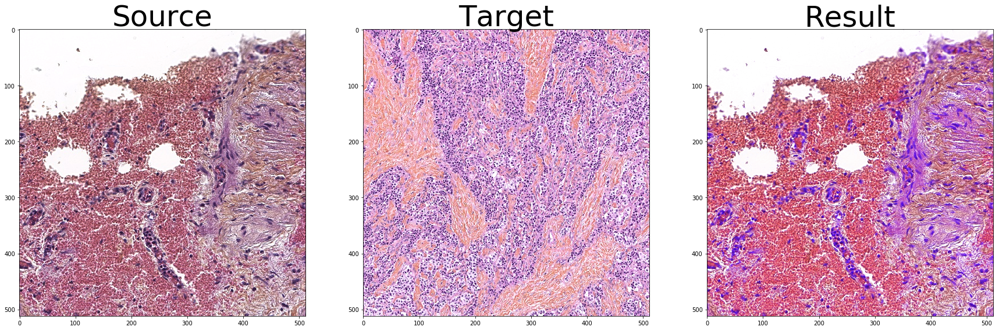

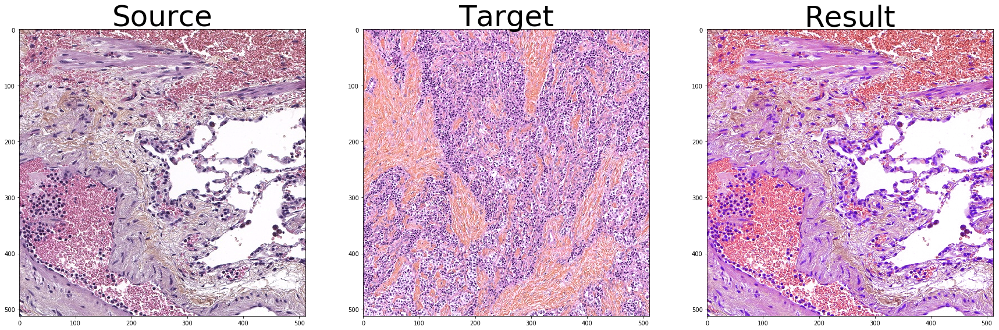

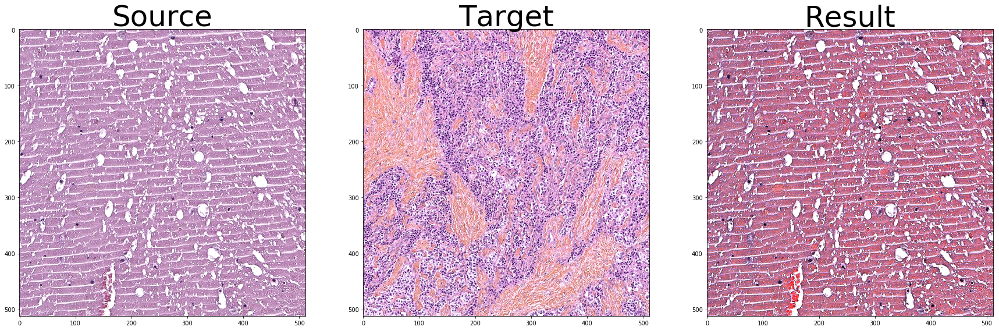

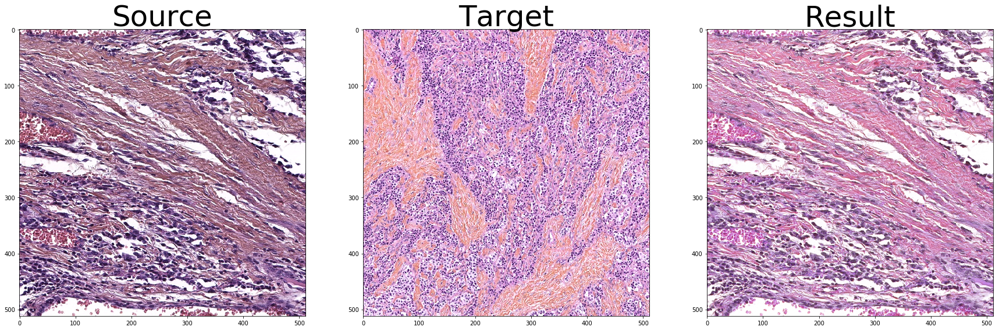

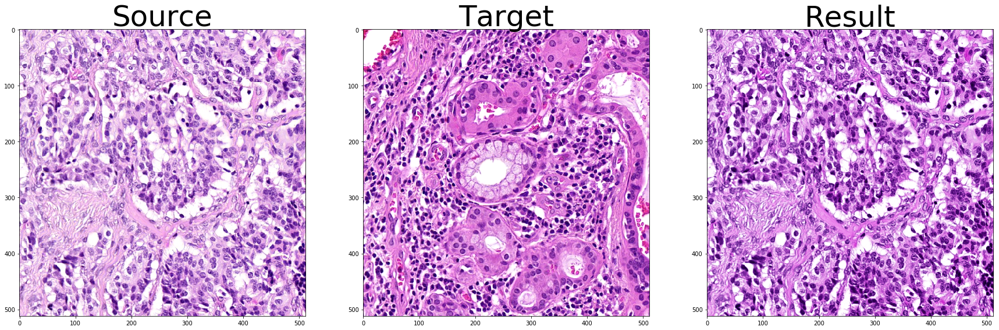

In [23]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd 
import spams
import cv2
import utils
from vahadane import vahadane
from sklearn.manifold import TSNE
import os
import pandas as pd

df_LNEN = pd.read_csv('/home/mathiane/ImgProcessing/Data/Slides_LNEN_CIRC.csv')

directory   = '/home/mathiane/ImgProcessing/Data/'
directory_target   = '/home/mathiane/ln_LNEN_work_mathian/Tiles512_512'
TARGET_PATH_HE = directory_target + '/TNE0535/'+'TNE0535_8741_106629.jpg'
TARGET_PATH_HES = directory_target + '/TNE0952/'+'TNE0952_15733_17481.jpg'
target_imageHE = utils.read_image(TARGET_PATH_HE)
target_imageHES = utils.read_image(TARGET_PATH_HES)

vhdHES = vahadane(STAIN_NUM=3, LAMBDA1=0.01, LAMBDA2=0.01, fast_mode=0, getH_mode=0, ITER=50)
vhdHES.fast_mode=0;
vhdHES.getH_mode=0;
WtHES, HtHES = vhdHES.stain_separate(target_imageHES)
vhdHES.setWt(WtHES); 
vhdHES.setHt(HtHES); 

vhdHE = vahadane(STAIN_NUM=2, LAMBDA1=0.01, LAMBDA2=0.01, fast_mode=0, getH_mode=0, ITER=50)
vhdHE.fast_mode=0;
vhdHE.getH_mode=0;
WtHE, HtHE = vhdHE.stain_separate(target_imageHE)
vhdHE.setWt(WtHE); 
vhdHE.setHt(HtHE); 

print('\n Sources \n ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~')
## Separate the stain for all images in /Data

list_images = os.listdir(directory)
Images = []
for ele in list_images:
    if ele.find('jpg') != -1:
        sample_id = ele.split('.')[0].split(' ')[0].split('_')[0]
        print(sample_id)
        HES_HE = str(list(df_LNEN[df_LNEN.iloc[:,0] == sample_id ].iloc[:,4])[0])
        Images.append((ele, HES_HE))
n_Images = len(Images)
source_images = []
Ws_l = []
Hs_l = []
c = 0
for ele in Images:
    HES_HE = ele[1]
    SOURCE_PATH = directory + ele[0]
    source_image = utils.read_image(SOURCE_PATH)
    if HES_HE == 'HES':
        Ws, Hs = vhdHES.stain_separate(source_image)
        source_images.append((source_image, HES_HE))
        Ws_l.append(Ws)
        Hs_l.append(Hs)
    elif HES_HE == 'HE':
        Ws, Hs = vhdHE.stain_separate(source_image)
        source_images.append((source_image, HES_HE))
        Ws_l.append(Ws)
        Hs_l.append(Hs)
    else:
        print('error')
    c += 1
    print(c, '\n\n\n')


results2 = []
for i in range(len(source_images)):
    if source_images[i][1] == 'HES':
        results2.append(vhdHES.SPCN(source_images[i][0], Ws_l[i], Hs_l[i]))
    elif source_images[i][1] == 'HE':
        results2.append(vhdHE.SPCN(source_images[i][0], Ws_l[i], Hs_l[i]))
    else:
        print('error')

for i in range(len(results2)):
    plt.figure(figsize=(30, 10))
    plt.subplot(1,3,1)
    plt.title('Source', fontsize=50)
    plt.imshow(source_images[i][0])
    plt.subplot(1,3,2)
    if source_images[i][1] == 'HES':
        plt.title('Target', fontsize=50)
        plt.imshow(target_imageHES)
        plt.subplot(1,3,3)
        plt.title('Result', fontsize=50)
        plt.imshow(results2[i])
    elif source_images[i][1] == 'HE':
        plt.title('Target', fontsize=50)
        plt.imshow(target_imageHE)
        plt.subplot(1,3,3)
        plt.title('Result', fontsize=50)
        plt.imshow(results2[i])
    #plt.savefig(RESULT_PATH)
    plt.show()

In [8]:
import pandas as pd
df_LNEN = pd.read_csv('/home/mathiane/ImgProcessing/Data/Slides_LNEN_CIRC.csv')

In [9]:
df_LNEN.head()

,ID (anonyme),Envoi Iarc,scanner utilisÃ©,HES. IHC,HES/HE (Emilie),Origine,Diagnostique,Code Diag,In Osiris,Corrupted_Fully,corrupted_tiles,Pen Marks,Bubbles,Haemorrhage,Mucus,Few Tumoral Tissus,Cartilage,Aleveolus,General Comments
0,TNE0001,03/11/2020,Leica,HES,HES,Milan,Atypical,CA,YES,NaN,NaN,No,No,No,No,No,No,No,Easy structure
1,TNE0002,03/11/2020,Leica,HES,HE?,Milan,Atypical,CA,YES,NaN,NaN,No,No,No,Yes,No,No,No,Easy structure
2,TNE0003,03/11/2020,Leica,HES,HES,Milan,Typical,CT,YES,NaN,NaN,No,No,No,No,No,Yes,Yes,NaN
3,TNE0004,03/11/2020,Leica,HES,HES,Milan,Typical,CT,YES,NaN,NaN,No,No,Yes,YEs,No,Yes,Yes,Red Stqins
4,TNE0005,03/11/2020,Leica,HES,HES,Milan,Atypical,CA,YES,NO,Yes,No,NO,NaN,NaN,NaN,Yes,NaN,NaN


In [15]:
str(list(df_LNEN[df_LNEN.iloc[:,0] == 'TNE0001' ].iloc[:,4])[0])

'HES'

HELLO2
self.WtSortIndex  []
stain separation time: 0.19190192222595215 s
Wt   [[0.05465802 0.49216253]
 [0.99103072 0.82449695]
 [0.12194508 0.27925046]]

 Sources 
 ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
HELLO2
self.WtSortIndex  [[0 1]
 [1 0]
 [0 1]]
Before order W  [[0.69038766 0.33799256]
 [0.72343961 0.76177575]
 [0.         0.55268322]]
(0, 1)
(1, 0)
dist_ind  [0.5930955850523906, 0.44585825387379013]  pos[index_min_order]  (1, 0)
W  [[0.33799256 0.69038766]
 [0.76177575 0.72343961]
 [0.55268322 0.        ]]
stain separation time: 0.19174528121948242 s
1 



HELLO2
self.WtSortIndex  [[0 1]
 [1 0]
 [0 1]]
Before order W  [[0.51261123 0.19255753]
 [0.79850093 0.70927021]
 [0.31563585 0.67812784]]
(0, 1)
(1, 0)
dist_ind  [0.5464484882811772, 0.4101623551466747]  pos[index_min_order]  (1, 0)
W  [[0.19255753 0.51261123]
 [0.70927021 0.79850093]
 [0.67812784 0.31563585]]
stain separation time: 0.19731998443603516 s
2 



HELLO2
self.WtSortIndex  [[0 1]
 [1 0]
 [0 1]]
Before order W

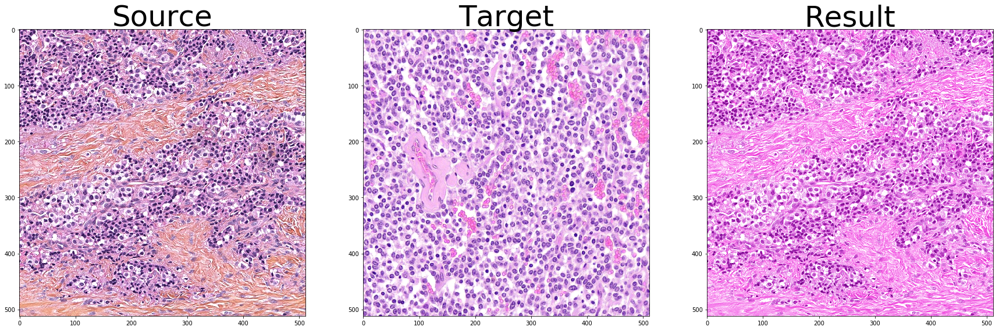

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import spams
import cv2
import utils
from vahadane import vahadane
from sklearn.manifold import TSNE
import os
directory   = '/home/mathiane/ImgProcessing/Data/'
TARGET_PATH = directory + 'TNE0289_875_56811.jpg'
target_image = utils.read_image(TARGET_PATH)
vhd = vahadane(STAIN_NUM=2, LAMBDA1=0.01, LAMBDA2=0.01, fast_mode=0, getH_mode=0, ITER=50)
vhd.fast_mode=0;
vhd.getH_mode=0;
Wt, Ht = vhd.stain_separate(target_image)
vhd.setWt(Wt); 
vhd.setHt(Ht)
print('Wt  ', vhd.Wt )
print('\n Sources \n ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~')
## Separate the stain for all images in /Data

list_images = os.listdir(directory)
Images = []
for ele in list_images:
    if ele.find('jpg') != -1:
        Images.append(ele)
n_Images = len(Images)
source_images = []
Ws_l = []
Hs_l = []
c = 0
for ele in Images:
    SOURCE_PATH = directory + ele
    source_image = utils.read_image(SOURCE_PATH)
    Ws, Hs = vhd.stain_separate(source_image)
    source_images.append(source_image)
    Ws_l.append(Ws)
    Hs_l.append(Hs)
    c += 1
    print(c, '\n\n\n')


results2 = []
for i in range(len(source_images)):
    source_images[i]
    results2.append(vhd.SPCN(source_images[i], Ws_l[i], Hs_l[i]))

for i in range(len(results2)):
    plt.figure(figsize=(30, 10))
    plt.subplot(1,3,1)
    plt.title('Source', fontsize=50)
    plt.imshow(source_images[i])
    plt.subplot(1,3,2)
    plt.title('Target', fontsize=50)
    plt.imshow(target_image)
    plt.subplot(1,3,3)
    plt.title('Result', fontsize=50)
    plt.imshow(results2[i])
    #plt.savefig(RESULT_PATH)
    plt.show()

In [121]:
import itertools
list(itertools.permutations([1, 2, 3]))

[(1, 2, 3), (1, 3, 2), (2, 1, 3), (2, 3, 1), (3, 1, 2), (3, 2, 1)]

In [126]:
np.arange(0,3)

array([0, 1, 2])

In [16]:
l1 = list(np.argsort(Wt, axis=1)[0,:])

In [17]:
d = { i:l1[i] for i in range(len(l1))}

In [77]:
Wt[0,:]

array([0.56261116, 0.24154499, 0.17777854])

In [79]:
Wt[:,0]

array([0.56261116, 0.74603784, 0.35622497])

In [80]:
np.argsort(Wt, axis=1)

array([[2, 1, 0],
       [2, 0, 1],
       [1, 0, 2]])

In [68]:
tsne = TSNE(n_components=2, init='pca', random_state=19980723)
data = np.concatenate((img[:, :, 0], img[:, :, 1], img[:, :, 2]), axis=0)
print(data.shape)
result = tsne.fit_transform(data.T)
print(result)

(1536, 512)
[[1264.4746    165.92099 ]
 [1290.2754    158.50276 ]
 [1466.5139    101.240395]
 ...
 [ -97.8847   -445.4226  ]
 [ -68.40153  -457.4438  ]
 [ -61.505424 -431.91507 ]]


In [54]:
data = np.concatenate((source_image[:,:,0],source_image[:,:,1],source_image[:,:,2]), axis=0)
print(data.shape)
result0 = tsne.fit_transform(data.T)
print(result0)

(1536, 512)
[[1056.4056  -100.19965]
 [1073.976   -114.4941 ]
 [1093.1522  -128.39091]
 ...
 [-224.20215 -242.58205]
 [-214.70522 -266.6563 ]
 [-194.64098 -258.14508]]


In [ ]:
t_min = result.min(axis=0)
t_max = result.max(axis=0)
result = (result - t_min) / (t_max - t_min)
t_min = result0.min(axis=0)
t_max = result0.max(axis=0)
result0 = (result0 - t_min) / (t_max - t_min)
print(result)
print(result0)
plt.figure(figsize=(30, 30))
plt.subplot(2,2,1)
plt.plot(result[:, 0], result[:, 1], 'r.')
plt.subplot(2,2,2)
plt.plot(result0[:,0], result0[:,1], 'r.')
plt.show()